In this notebook, we evaluate the AutoEncoder at different ADC ranges

In [1]:
import sys
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import load_model
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
import math

In [2]:
wireplane = 'U'
np.random.seed(42)

def filter_signal_ADC(data, clean_data, adc_value, filter_by_max):
    data_wf = []
    clean_wf = []
    for i in range(clean_data.shape[0]):
        if filter_by_max:
            if max(clean_data[i]) < adc_value or sum(clean_data[i]) == 0:
                data_wf.append(data[i])
                clean_wf.append(clean_data[i])
        else:
            if max(clean_data[i]) > adc_value or sum(clean_data[i]) == 0:
                data_wf.append(data[i])
                clean_wf.append(clean_data[i])
    data_wf = np.array(data_wf)
    clean_wf = np.array(clean_wf)
    return data_wf, clean_wf

Load testing set

In [3]:
x_test = np.load('../processed_data/current/x_test_' + wireplane + '.npy')
y_test = np.load('../processed_data/current//y_test_AE_' + wireplane + '.npy')
mean = np.load('../latest_models/mean_' + wireplane + '_nu.npy')
std = np.load('../latest_models/scale_' + wireplane + '_nu.npy')

### Finding ranges where there are signals

In [4]:
def combine_overlapping_ranges(ranges):
    # sort the original list in ascending order according to the first element in each sublist
    ranges = sorted(ranges, key=lambda x: x[0])

    # initialize the result list
    result = []

    # iterate over the sorted list and combine overlapping sublists
    for range in ranges:
        if result and range[0] <= result[-1][1]:
            # combine the current sublist with the previous one
            result[-1] = [min(range[0], result[-1][0]), max(range[1], result[-1][1])]
        else:
            # no overlap, so simply append the current sublist to the result
            result.append(range)

    return result

In [5]:
# takes single wave (array), and baseline (the value at which the wave is flat) and returns
# a list of ranges where there are signals waveforms
from scipy.signal import find_peaks
def find_peak_range(array):
    baseline = 0
    array = abs(array)
    # find the peaks
    peaks, _ = find_peaks(array)
    peak_ranges = []
    start_spc = 0
    end_spc = 0

    if abs(array[0]) > baseline:
        end_spc = 0
        while end_spc < 200 and ((array[end_spc] > baseline) or (array[end_spc] < baseline)):
            end_spc += 1

    for peak in peaks:
        if peak == end_spc:
            end = peak
            while end < 200 and array[end] > abs(baseline):
                end += 1
            if [start_spc, end] not in peak_ranges:
                peak_ranges.append([start_spc, end])

        else:
            start = peak
            while start > 0 and array[start] > abs(baseline):
                start -= 1
        
            end = peak
            while end < 200 and array[end] > abs(baseline):
                end += 1
            if [start, end] not in peak_ranges:
                peak_ranges.append([start, end])

    peak_ranges = combine_overlapping_ranges(peak_ranges)

    return peak_ranges

perform scan of dataset and see how many ranges are produced for each waveforms, then inpect wavefroms that have high numbers of seperate ranges

In [6]:
#num = 0
#for debug_wave in y_test:
#    if sum(np.array(debug_wave)) != 0:
#        range = find_peak_range(debug_wave, 0)
#        if len(range) > 3:
#            fig = plt.figure(figsize=(10,4))
#            plt.plot(debug_wave, label= str(range))
#            plt.legend(fontsize=12)
#            filename = 'scan-ranges/scan_'+str(num)+'.png'
#            plt.savefig(filename, facecolor='w')
#    num+=1

        

In [7]:
#for num in range(100):
#    debug_wave = y_test[num]
#    if sum(np.array(debug_wave)) != 0:
#        fig = plt.figure(figsize=(10,4))
#        plt.plot(debug_wave, label= str(find_peak_range(debug_wave)))
#        plt.legend(fontsize=12)
#        filename = 'ranges/combine_phase1_'+str(num)+'.png' 
#        plt.savefig(filename, facecolor='w')
#        plt.close()

create a "soft bound" where if two ranges that are detected as signal are "close enough" within those bounds, merge them

In [8]:
def merge_ranges(wave, bound):
    # range_b1 is the ranges after merging using bound = 1
    range_b1 = find_peak_range(wave)
    idx = 0
    while idx < len(range_b1) - 1:
        if range_b1[idx][1] + bound >= range_b1[idx+1][0]:
            range_b1[idx][1] = max(range_b1[idx][1], range_b1[idx+1][1])
            del range_b1[idx+1]
        else:
            idx += 1
    return range_b1

In [9]:
# find ranges where there are no signals using ranges
# where there are signals as input
def get_non_signal_ranges(signal_ranges):
    output = []
    start = 0
    # signal_ranges.sort()  # more efficient for unsorted input
    for subrange in signal_ranges:
        if start < subrange[0]:
            output.append([start, subrange[0]])
        start = subrange[1]
        # start = max(subrange[0], start)  # more efficient for unsorted input
    if start < 200:
        output.append([start, 200])
    return output

In [10]:
#for num in range(100):
#    debug_wave = y_test[num]
#    if sum(np.array(debug_wave)) != 0:
#        fig = plt.figure(figsize=(10,4))
#        plt.plot(debug_wave, label= str(merge_ranges(debug_wave, 5)))
#        plt.legend(fontsize=12)
#        filename = 'ranges/combine_phase2_'+str(num)+'.png' 
#        plt.savefig(filename, facecolor='w')
#        plt.close()

#### Get all the ranges where there are signals

In [11]:
ranges = []
for wave in y_test:
    ranges.append(merge_ranges(wave, 5))

In [12]:
print(y_test.shape[0], len(ranges))

100000 100000


### Finding ranges where there are signals - DONE!

_______________________________________________________________________________________________________________________________

In [13]:
x_test_scaled = (x_test-mean)/std

In [14]:
y_test_scaled = []
for i in range(len(y_test)):
    if sum(y_test[i]) == 0:
        y_test_scaled.append(y_test[i])
    else:
        scaled = (y_test[i]-mean)/std
        y_test_scaled.append(scaled)
y_test_scaled = np.array(y_test_scaled)


Load trained model

In [15]:
import Custom_MSE as func
import tqdm
def custom_mse2(y_true, y_pred):
    np_y_pred = y_pred.numpy()
    np_y_true = y_true.numpy()
    batch_size = np_y_pred.shape[0]

    y_true_rescaled = []
    print('rescalling y_true...')
    for i in tqdm.trange(len(np_y_true)):
        if sum(np_y_true[i]) == 0:
            y_true_rescaled.append(np_y_true[i])
        else:
            y_true_rescaled.append((std*np_y_true[i]+mean))
    y_true_rescaled = np.array(y_true_rescaled)

    sig_ranges = []
    print('finding ranges where there are signals: ') 
    for i in tqdm.trange(len(y_true_rescaled)):
        wave =  y_true_rescaled[i]
        sig_ranges.append(funcs.merge_ranges(wave, 5))
    print("finding ranges where there are no signals: ")
    no_sig_ranges = funcs.get_non_signal_ranges(sig_ranges)

    for i in range(10):
        print('DEBUG MESSAGE: ',sig_ranges[i], '---', no_sig_ranges[i])

    print('calculating MSEs')
    total_mse = 0
    for i in tqdm.trange(len(y_true_rescaled)):
        if sum(y_true_rescaled[i]) == 0:
            # total_mse += funcs.calculate_single_mse_helper(np_y_true[i], np_y_pred[i])
            total_mse += funcs.calculate_single_mse_helper(y_true[i], y_pred[i])
        else:
            # total_mse += funcs.calculate_single_mse(np_y_true[i], np_y_pred[i], sig_ranges[i])
            total_mse += funcs.calculate_single_mse(y_true[i], y_pred[i], sig_ranges[i], no_sig_ranges[i])
    
    loss = total_mse/batch_size

    return loss

In [ ]:
autoencoder = load_model("TEST_" + wireplane + 'plane_nu.h5', custom_objects={'custom_mse2':custom_mse2})

In [16]:
autoencoder = load_model("FIRST_TRAIN.h5", custom_objects={'custom_mse2':custom_mse2})

In [17]:
tf.executing_eagerly()

True

### let's see what the MSE is at the region where signal exists

In [18]:
%%time
predictions = autoencoder.predict(x_test_scaled, batch_size=4096)
predictions = predictions.reshape(predictions.shape[0], predictions.shape[1])

25/25 [==============================] - 9s 51ms/step
Wall time: 9.88 s


Plot predicted wave on top of target and input

In [19]:
x_test_ = std*x_test_scaled+mean
y_test_ = std*y_test_scaled+mean
pred_ = predictions*std+mean

In [20]:
print(len(x_test_), len(y_test_), len(pred_))

100000 100000 100000


### DEBUG -- apply ADC-CUT

#### generate plots of model's prediction on top of input & clean target (ADC CUT APPLIED)

In [21]:
#for idx in range(len(x_test_)):
#    max_adc = int((max(x_test_[idx])))
#    if sum(y_test_scaled[idx]) != 0:
#        if max_adc < 15:
#            fig, (ax1) = plt.subplots(figsize=(12, 4), facecolor='white')
#            ax1.plot(y_test_[idx],color='blue', label='target')
#            ax1.plot(pred_[idx],color='m',alpha=0.7, label='model prediction')
#            ax1.plot(x_test_[idx], color='orange',alpha=0.7, label = 'original input (adc_max: ' + str(max_adc) + ')')
#            ax1.set_title("trained using clean signals as target", fontsize=15)
#            ax1.legend()
#            filename = 'plane_u_AE_plots_ADC_MAX_15_no_noise/'+str(idx)+'.png' 
#            plt.savefig(filename, facecolor='w')
#            plt.close()

### DEBUG -- apply ADC-CUT -- NOT DONE

-----------------------------------------------------------------------------

#### generate plots of model's prediction on top of input & clean target (ALL)

In [22]:
#for idx in range(len(x_test_)):
#    fig, (ax1) = plt.subplots(figsize=(12, 4), facecolor='white')
#    ax1.plot(y_test_[idx],color='blue', label='target')
#    ax1.plot(pred_[idx],color='m',alpha=0.7, label='model prediction')
#    ax1.plot(x_test_[idx], color='orange',alpha=0.7, label = 'original input')
#    ax1.set_title("trained using clean signals as target", fontsize=15)
#    ax1.legend()
#    filename = 'plane_u_AE_plots/'+str(idx)+'.png' 
#    plt.savefig(filename, facecolor='w')
#    plt.close()

Checkpoint reached

In [23]:
# calculate MSE for the entire range
mse = np.mean((y_test_scaled - predictions)**2)
print("MSE for entire range:", mse)

MSE for entire range: 0.060022931899564064


### Calculate MSE with new ranges

In [24]:
# helper to calculate mse of segments or full wave
def calculate_single_mse_helper(seqment_wave, seqment_pred_wave):
    single_mse = np.mean((seqment_wave-seqment_pred_wave)**2)
    return single_mse

In [25]:
# helper to calculate mse of segments or full wave
def calculate_single_mse_helper(seqment_wave, seqment_pred_wave):
    single_mse = np.mean((seqment_wave-seqment_pred_wave)**2)
    return single_mse

# helper method to calculate mse given some ranges
def segment_mse_helper(expected, prediction, wave_ranges, flag):
    expected_waves = []
    pred_waves = []
    mses = []

    for range_ in wave_ranges:
        expected_wave = expected[range_[0]:range_[1]]
        pred_wave = prediction[range_[0]:range_[1]]
        curr_mse = calculate_single_mse_helper(expected_wave, pred_wave)
        if flag:
            print('signal region--> range:', range_, ' mse:',curr_mse)
        else:
            print('non-signal region--> range:', range_, ' mse:',curr_mse)
        mses.append(curr_mse)
    
    mse = sum(mses)
    return mse

def calculate_single_mse(expected, prediction, signal_ranges, non_signal_ranges):
    print('signal ranges: ', str(signal_ranges),'non_signal ranges: ', str(non_signal_ranges))
    
    signal_region = 0
    full_window = calculate_single_mse_helper(expected, prediction)
    no_signal_region = 0
    print("full window :", full_window)
    
    if sum(expected) != 0:
        signal_region = segment_mse_helper(expected, prediction, signal_ranges, True)
        no_signal_region = segment_mse_helper(expected, prediction, non_signal_ranges, False)

        print('signal region: ', signal_region)
        print('non-signal region: ', no_signal_region)

    return [full_window, signal_region, no_signal_region] 

In [26]:
index = 5
ex = y_test_scaled[index]
pred = predictions[index]
rng = ranges[index]

signal ranges:  [[22, 44]] non_signal ranges:  [[0, 22], [44, 200]]
full window : 0.005951338215046653
signal region--> range: [22, 44]  mse: 0.03218928635908544
non-signal region--> range: [0, 22]  mse: 0.00347636531161782
non-signal region--> range: [44, 200]  mse: 0.0026001493990631974
signal region:  0.03218928635908544
non-signal region:  0.006076514710681017
[0.005951338215046653, 0.03218928635908544, 0.006076514710681017]


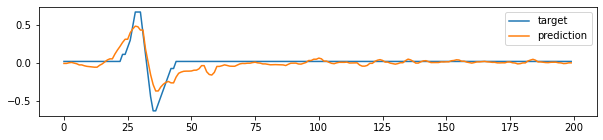

In [27]:

print(calculate_single_mse(ex, pred, rng,get_non_signal_ranges(rng)))
fig = plt.figure(figsize=(10,2))
plt.plot(ex, label="target")
plt.plot(pred, label="prediction")
plt.legend()
plt.show()

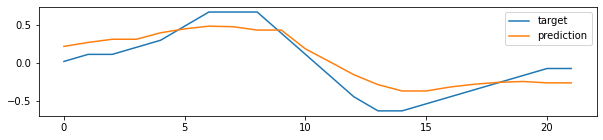

0.03218928635908544


In [28]:

tes_ex = ex[rng[0][0]:rng[0][1]]
tes_pred = pred[rng[0][0]:rng[0][1]]
fig = plt.figure(figsize=(10,2))
plt.plot(tes_ex, label="target")
plt.plot(tes_pred, label="prediction")
plt.legend()
plt.show()
print(calculate_single_mse_helper(tes_ex, tes_pred))

In [29]:
i=5
ex = y_test_scaled[i]
pred = predictions[i]
rng = ranges[i]
wave_mse = calculate_single_mse(ex, pred, rng, get_non_signal_ranges(rng))
for i in range(3):
    print(wave_mse[i], i)
# runtime ~ 2min
print(wave_mse)

signal ranges:  [[22, 44]] non_signal ranges:  [[0, 22], [44, 200]]
full window : 0.005951338215046653
signal region--> range: [22, 44]  mse: 0.03218928635908544
non-signal region--> range: [0, 22]  mse: 0.00347636531161782
non-signal region--> range: [44, 200]  mse: 0.0026001493990631974
signal region:  0.03218928635908544
non-signal region:  0.006076514710681017
0.005951338215046653 0
0.03218928635908544 1
0.006076514710681017 2
[0.005951338215046653, 0.03218928635908544, 0.006076514710681017]


#### calculate MSES for entire test set

In [30]:
full = []
signal = []
no_signal = []
for i in range(len(ranges)):
    ex = y_test_scaled[i]
    pred = predictions[i]
    rng = ranges[i]
    wave_mse = calculate_single_mse(ex, pred, rng, get_non_signal_ranges(rng))
    full.append(wave_mse[0])
    signal.append(wave_mse[1])
    no_signal.append(wave_mse[2])
# runtime ~ 2min

signal ranges:  [] non_signal ranges:  [[0, 200]]
full window : 0.00030067449327498815
signal ranges:  [] non_signal ranges:  [[0, 200]]
full window : 8.344751170085376e-05
signal ranges:  [] non_signal ranges:  [[0, 200]]
full window : 0.001748462317186597
signal ranges:  [] non_signal ranges:  [[0, 200]]
full window : 0.0002809237458854328
signal ranges:  [] non_signal ranges:  [[0, 200]]
full window : 0.0008544891650543834
signal ranges:  [[22, 44]] non_signal ranges:  [[0, 22], [44, 200]]
full window : 0.005951338215046653
signal region--> range: [22, 44]  mse: 0.03218928635908544
non-signal region--> range: [0, 22]  mse: 0.00347636531161782
non-signal region--> range: [44, 200]  mse: 0.0026001493990631974
signal region:  0.03218928635908544
non-signal region:  0.006076514710681017
signal ranges:  [] non_signal ranges:  [[0, 200]]
full window : 0.00016232353961775773
signal ranges:  [[97, 179]] non_signal ranges:  [[0, 97], [179, 200]]
full window : 0.2222467057479206
signal region

In [31]:
print(any([math.isnan(x) for x in full]), any([math.isnan(x) for x in signal]), any([math.isnan(x) for x in no_signal]))
print(len(full), len(signal), len(no_signal))

False False False
100000 100000 100000


### RESULT

In [32]:
print('Total MSE (mean) - full window:        ', np.mean(full))
print('Total MSE (mean) - signal region:      ', np.mean(signal))
print('Total MSE (mean) - non-signal region:  ', np.mean(no_signal))

Total MSE (mean) - full window:         0.06002293189956398
Total MSE (mean) - signal region:       0.15125870239330766
Total MSE (mean) - non-signal region:   0.008319365203823993


### Calculate MSE with new ranges ---  DONE

______________________________________________________________________________________________________________________

### GENERATE PLOTS with 1DCNN FLAGS + MSE INFO

In [33]:
model_1dcnn = load_model('../latest_models/model_' + wireplane + 'plane_nu.h5')

In [34]:
y_test_ROI = np.load('../processed_data/current/y_test_ROI_' + wireplane + '.npy')

25/25 [==============================] - 1s 23ms/step


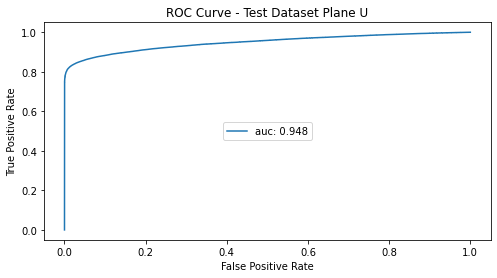

In [35]:
x_test_scaled_ROI = np.array(x_test_scaled)
all_infer = model_1dcnn.predict(x_test_scaled_ROI, batch_size=4096)
fpr_keras, tpr_keras, thresholds_keras = roc_curve(y_test_ROI, all_infer)
plt.figure(figsize=(8, 4))  
plt.plot(fpr_keras, tpr_keras, label='auc: ' + str(round(auc(fpr_keras, tpr_keras), 3)))
plt.title("ROC Curve - Test Dataset Plane " + wireplane)
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend(loc='center')

In [36]:
pred_ROI = all_infer.squeeze()
print(pred_ROI.shape)

(100000,)


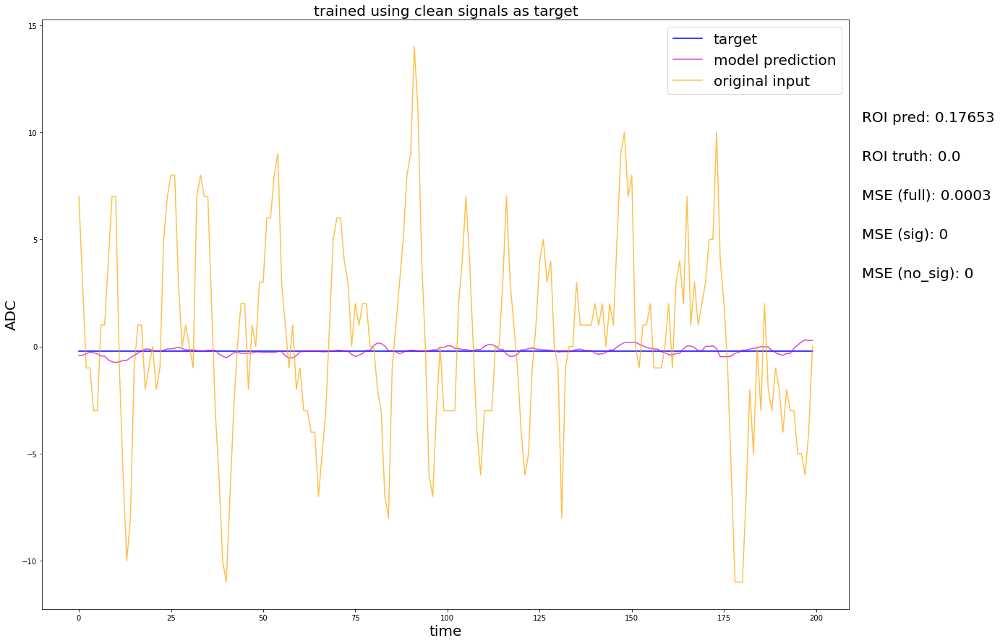

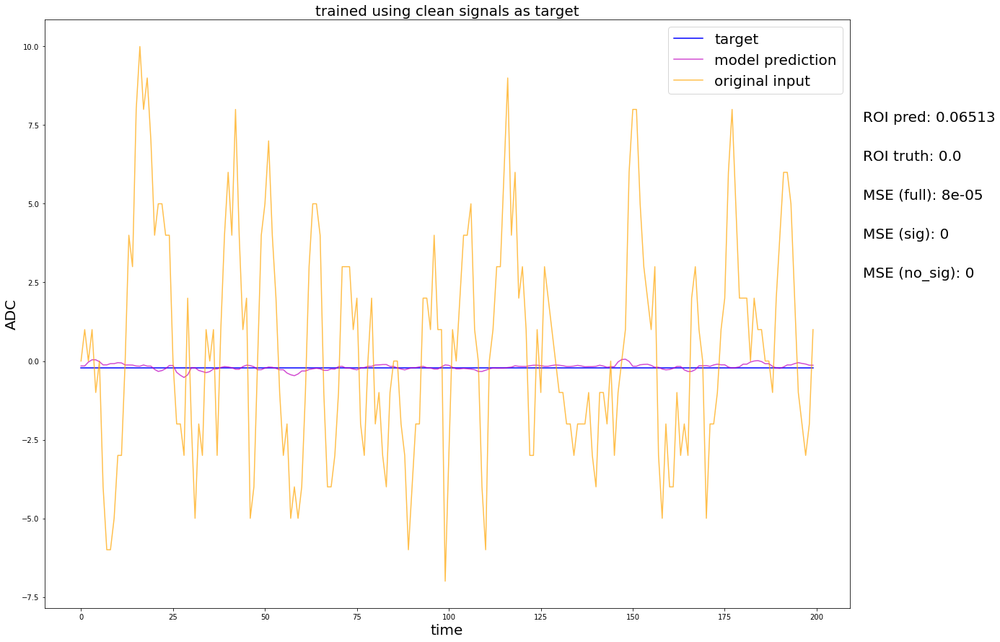

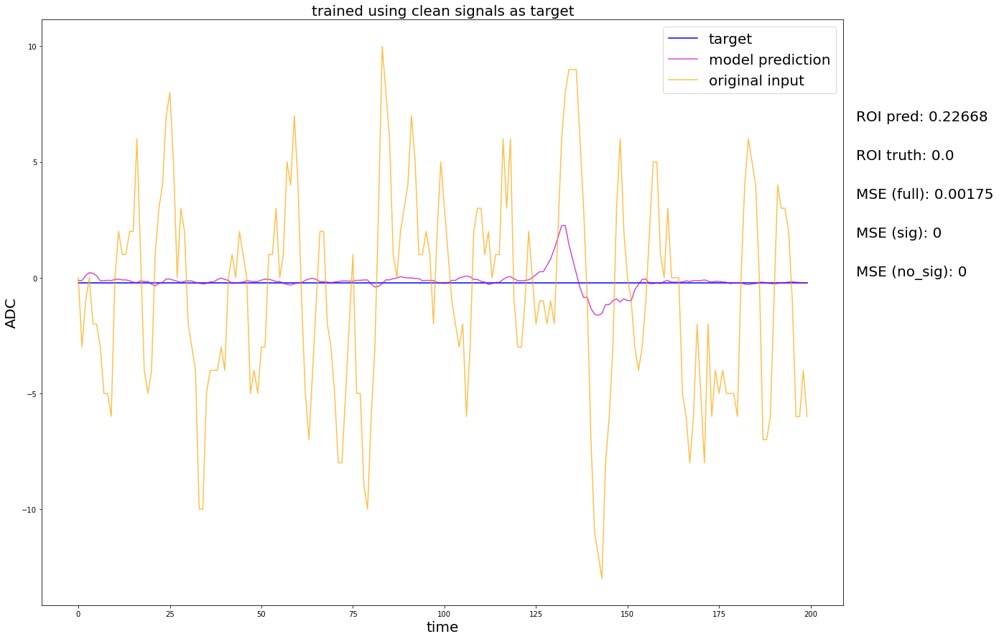

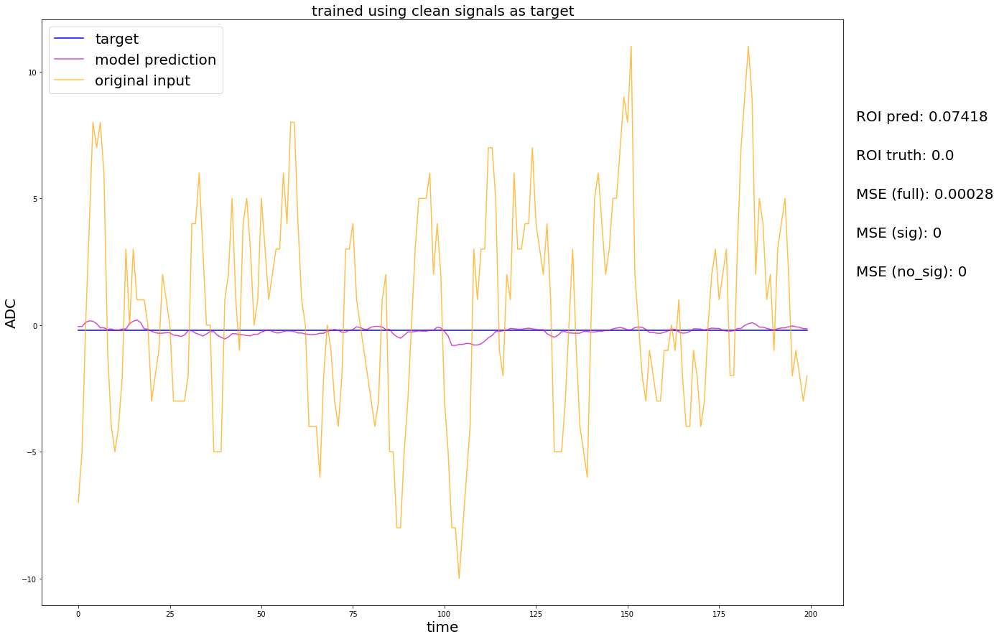

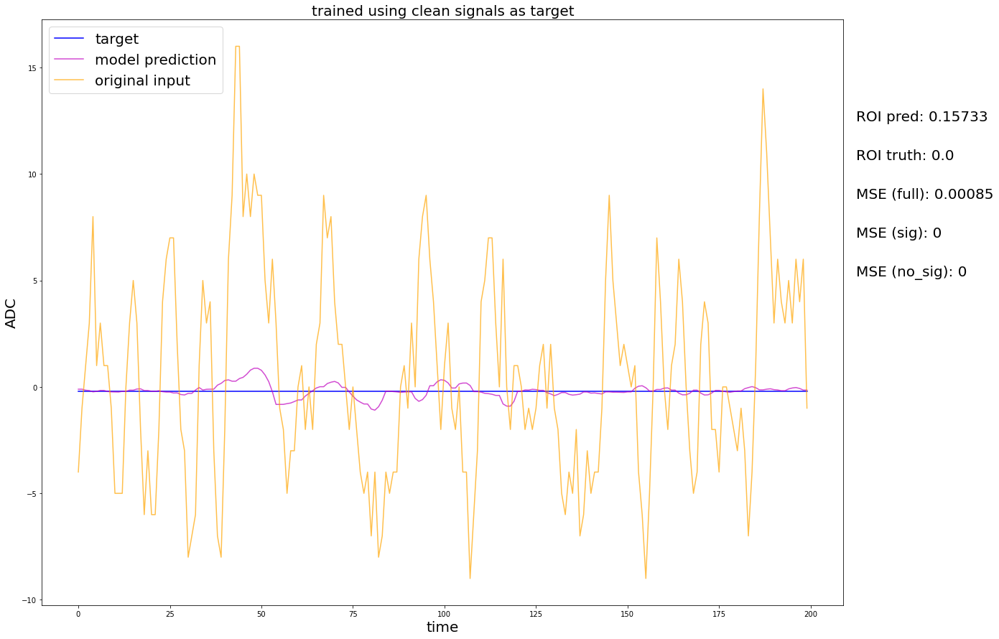

...

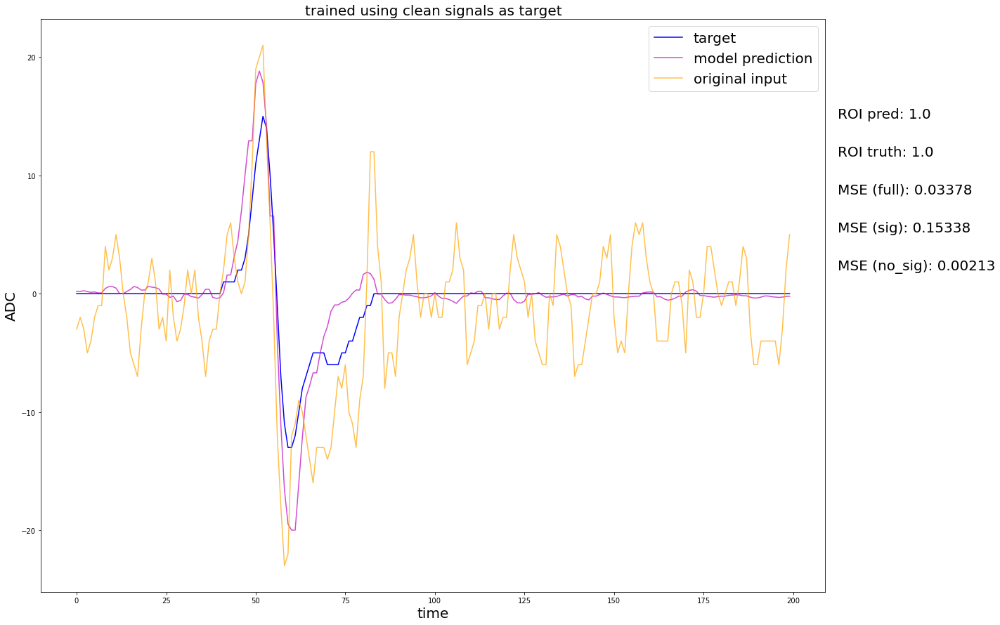

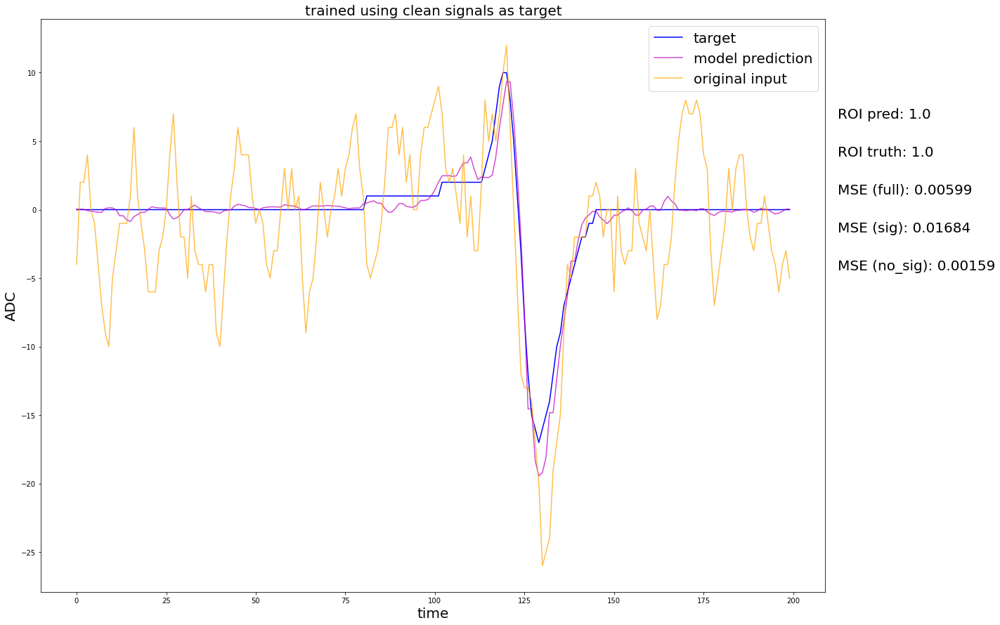

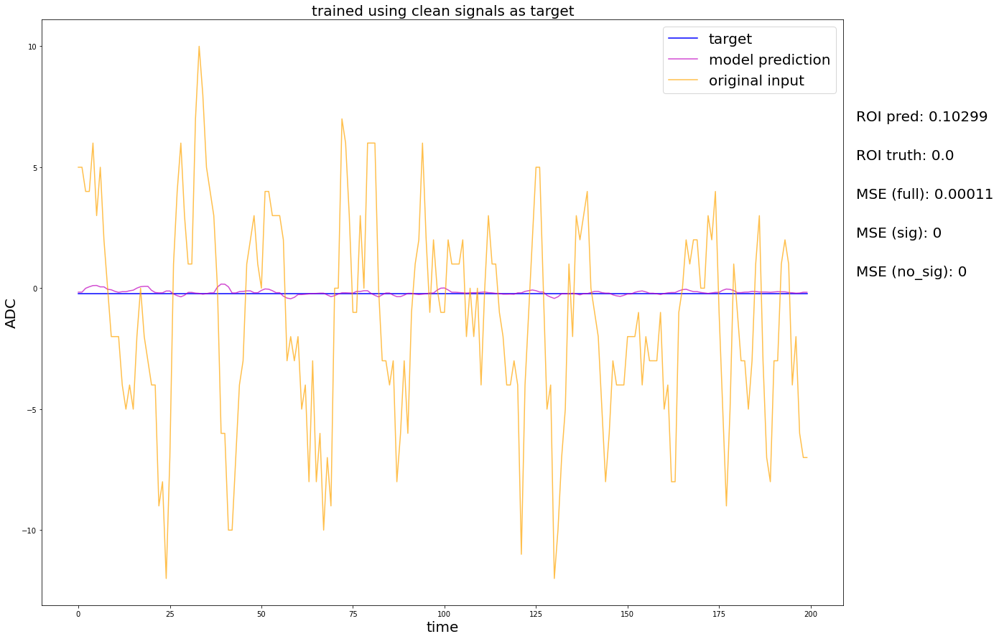

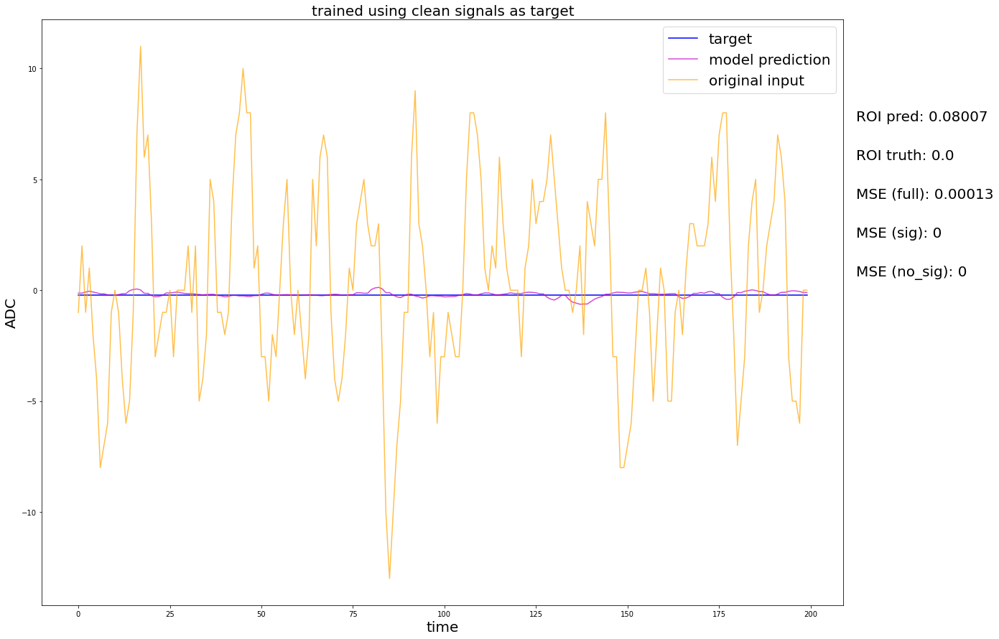

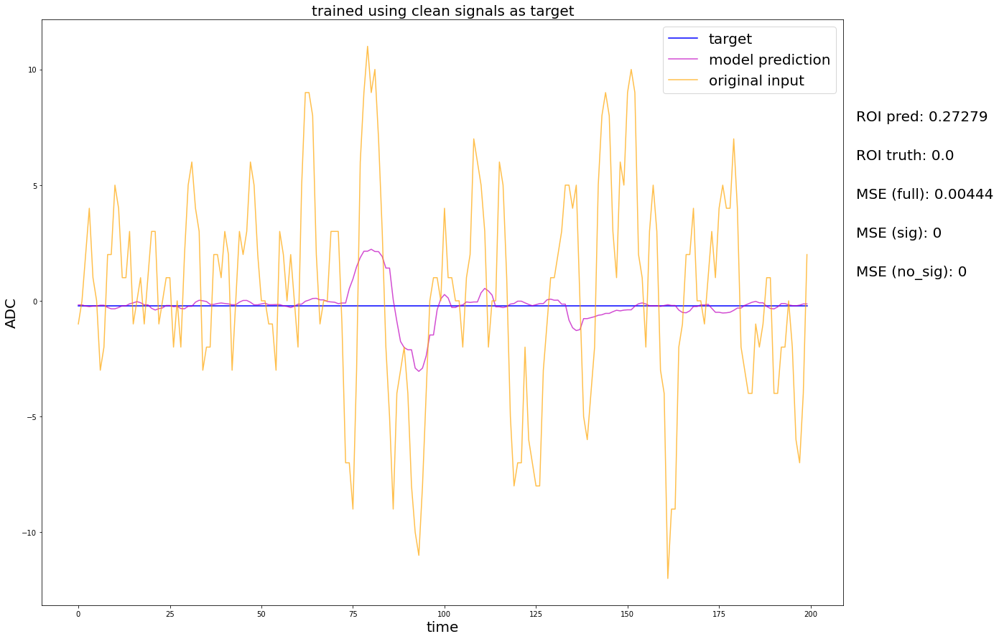

In [37]:
for idx in range(100):
    fig, (ax1) = plt.subplots(figsize=(20, 15), facecolor='white')
    ax1.plot(y_test_[idx],color='blue', label='target')
    ax1.plot(pred_[idx],color='m',alpha=0.7, label='model prediction')
    ax1.plot(x_test_[idx], color='orange',alpha=0.7, label = 'original input')
    ax1.set_title("trained using clean signals as target", fontsize=20)
    ax1.legend(fontsize=20)
    plt.figtext(0.9125, 0.75, 'ROI pred: ' + str(np.round(pred_ROI[idx],5)), fontsize=20)
    plt.figtext(0.9125, 0.7, 'ROI truth: ' + str(np.round(y_test_ROI[idx],5)), fontsize=20)
    plt.figtext(0.9125, 0.65, 'MSE (full): ' + str(np.round(full[idx],5)), fontsize=20)
    plt.figtext(0.9125, 0.6, 'MSE (sig): ' + str(np.round(signal[idx],5)), fontsize=20)
    plt.figtext(0.9125, 0.55, 'MSE (no_sig): ' + str(np.round(no_signal[idx],5)), fontsize=20)
    plt.xlabel('time', fontsize=20)
    plt.ylabel('ADC', fontsize=20)
    #filename = 'plane_u_mega_plots/'+str(idx)+'.png' 
    #plt.savefig(filename, facecolor='w', bbox_inches='tight')

    plt.show()



### GENERATE PLOTS with 1DCNN FLAGS + MSE INFO -- NOT COMPLETE

-----------------------------------------------------------------------------------------------------------------------------

### BELOW -- NEED TO LOOK AT AGAIN

Next: at the moment MSEs are being calculating for just one range. However there are waves with multiple ranges. We need to take this into account

In [38]:
print(calculate_single_mse(x_test_scaled[0], predictions[15]))

TypeError: calculate_single_mse() missing 2 required positional arguments: 'signal_ranges' and 'non_signal_ranges'

NOTE: MSE IS CALCULATED FOR ONE WAVE. NEED TO LOOP TO GET ALL WAVES

In [ ]:
# adc_max = 0 means no max cut is applied
def eval_cut_(x_test_, y_test_, adc_min, adc_max):
    print(x_test_.shape, y_test_.shape)

    test_, clean_ =  filter_signal_ADC(x_test_, y_test_, adc_min, False)
    print(test_.shape, clean_.shape)
    if adc_max != 0:
        test_, clean_ =  filter_signal_ADC(test_, clean_, adc_max, True)
    print(test_.shape, clean_.shape)


    x_test_scaled_ = (x_test_-mean)/std
    clean_scaled_ = clean_
    
    y_test_scaled_ = []
    for i in range(len(y_test_)):
        if sum(y_test_[i]) == 0:
            y_test_scaled_.append(y_test_[i])
        else:
            scaled_ = (y_test_[i]-mean)/std
            y_test_scaled_.append(scaled_)
    y_test_scaled_ = np.array(y_test_scaled_)


    all_pred = autoencoder.predict(x_test_scaled, batch_size=4096)
    all_pred = all_pred.reshape(all_pred.shape[0], all_pred.shape[1])

    MSES_ = []
    nan_idxs_ = []
    for idx in range(len(y_test_scaled)):
        mse_ = calculate_single_mse(y_test_scaled[idx], all_pred[idx])

        if not np.isnan(mse_):
            MSES.append(mse_)
        else:
            nan_idxs_.append(idx)
    return MSES, nan_idxs_

In [ ]:
mse_3_15 = []
nans_3_15 = []
for i in range(3, 16):
    eval_cut_(x_test, y_test, i, 0)
    mses_, nans = eval_cut_(x_test, y_test, i, 0)
    mse_3_15.append([mses_])
    nans_3_15.append([nans])


In [ ]:
print(len(mse_3_15), len(nans_3_15))

In [ ]:
mse_3_15